# Exploratory Data Analysis

## Get data from 'raw_data.csv' 

In [1]:
import pandas as pd
import os
from ydata_profiling import ProfileReport
from ML_figures.figures import element_prevalence
from matplotlib import pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
current_dir = os.getcwd()
file_path = os.path.join(current_dir, './data/raw_data.csv')

raw_data = pd.read_csv(file_path)

In [3]:
raw_data

,material_id,formula_pretty,composition,crystal_system,space_group,point_group,band_gap,volume,density,density_atomic,formation_energy_per_atom,e_total,e_ionic,e_electronic
0,mp-28967,Ba(PdS2)2,Ba2 Pd4 S8,Monoclinic,11,2/m,0.7792,316.341404,5.022717,22.595815,-1.124079,17.048334,7.118969,9.929365
1,mp-766094,NbO2F,Nb4 O8 F4,Orthorhombic,19,222,2.8980,253.915299,3.764366,15.869706,-3.099174,17.572010,13.469477,4.102533
2,mp-36577,Sr(AsS2)2,Sr1 As2 S4,Triclinic,1,1,1.7212,196.220495,3.094976,28.031499,-0.766100,18.488667,12.443616,6.045051
3,mp-1102092,NaFe(SO4)2,Na4 Fe4 S8 O32,Monoclinic,12,-1,2.0944,620.336826,2.901260,12.923684,-1.948264,9.596025,6.499905,3.096120
4,mp-720391,BH4NF4,B4 H16 N4 F16,Orthorhombic,62,mmm,7.4812,374.200384,1.860992,9.355010,-1.970766,6.216546,4.350314,1.866232
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7272,mp-759283,FeOF,Fe4 O4 F4,Monoclinic,6,m,0.4687,140.001215,4.309906,11.666768,-2.077375,15.436682,10.943471,4.493211
7273,mp-752498,Li2VOF5,Li2 V1 O1 F5,Orthorhombic,44,mm2,3.2968,125.816773,2.320418,13.979641,-2.908932,14.103889,11.850884,2.253005
7274,mp-29983,Cs6Cl4O,Cs12 Cl8 O2,Trigonal,167,-3m,1.9928,861.371433,3.683011,39.153247,-1.904219,9.068753,6.383751,2.685002
7275,mp-568024,ICl,I8 Cl8,Monoclinic,14,2/m,1.4968,579.503390,3.721820,36.218962,-0.483976,5.902496,2.110160,3.792336


## To determine if there are NaN values in the data:

In [4]:
raw_data.isna().any()

material_id                  False
formula_pretty               False
composition                  False
crystal_system               False
space_group                  False
point_group                  False
band_gap                     False
volume                       False
density                      False
density_atomic               False
formation_energy_per_atom    False
e_total                      False
e_ionic                      False
e_electronic                 False
dtype: bool

::There are not NaN in the data

In [5]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7277 entries, 0 to 7276
Data columns (total 14 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   material_id                7277 non-null   object 
 1   formula_pretty             7277 non-null   object 
 2   composition                7277 non-null   object 
 3   crystal_system             7277 non-null   object 
 4   space_group                7277 non-null   int64  
 5   point_group                7277 non-null   object 
 6   band_gap                   7277 non-null   float64
 7   volume                     7277 non-null   float64
 8   density                    7277 non-null   float64
 9   density_atomic             7277 non-null   float64
 10  formation_energy_per_atom  7277 non-null   float64
 11  e_total                    7277 non-null   float64
 12  e_ionic                    7277 non-null   float64
 13  e_electronic               7277 non-null   float

In [6]:
raw_data.describe()
# Focuse the minimum value and find if there are some error values

,space_group,band_gap,volume,density,density_atomic,formation_energy_per_atom,e_total,e_ionic,e_electronic
count,7277.000000,7277.000000,7277.000000,7277.000000,7277.000000,7277.000000,7277.000000,7277.000000,7277.000000
mean,97.351931,2.328964,289.582052,4.402645,18.866027,-1.702746,50.967904,32.435320,18.532584
std,76.170554,1.691062,221.545397,1.858210,8.591112,0.982772,1656.585187,1489.248036,626.217070
min,1.000000,0.000000,11.286588,0.023670,5.643294,-4.509148,1.155248,0.000000,-64.837332
25%,19.000000,1.003500,143.461414,3.085919,12.585297,-2.481756,7.930701,4.000432,2.941051
50%,82.000000,1.974600,233.953435,4.136236,15.917620,-1.648019,11.655871,6.467976,4.263057
75%,164.000000,3.409200,367.365384,5.348088,23.646638,-0.883874,18.958478,11.352121,6.548818
max,230.000000,9.335400,3998.471538,17.732855,132.548261,4.688205,126575.316823,126567.273642,46857.910510


## Profile Report
- And we can check the correlations between the features and dielectric constant

In [7]:
# profile = ProfileReport(raw_data.copy(), title='Pandas Profiling Report of raw dataset', html={'style':{'full_width':True}})
# profile.to_widgets()
# spend too much time to run the code, so I comment it

- Noticed significant correlations between certain attributes.
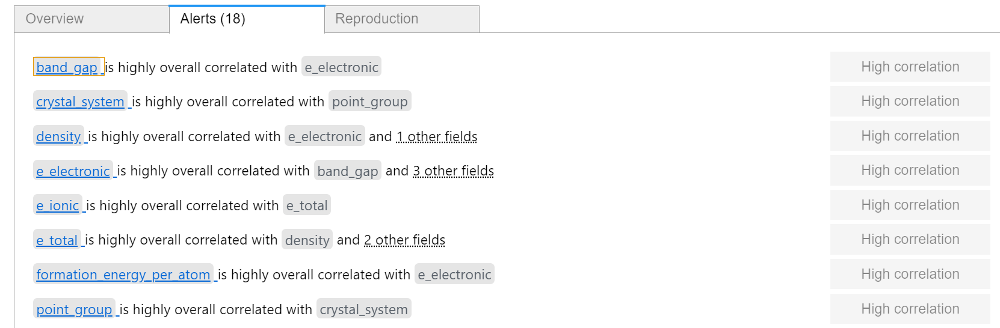

## Check for and remove duplicate entries

In [8]:
data_df = raw_data.drop_duplicates()

print(f'DataFrame shape after dropping duplicates: {data_df.shape}')

DataFrame shape after dropping duplicates: (7277, 14)


## Check the type of Compound

In [9]:
composition_type = data_df['composition'].unique()
composition_type

array(['Ba2 Pd4 S8', 'Nb4 O8 F4', 'Sr1 As2 S4', ..., 'Rb2 Tc2 O8',
       'Li2 V1 O1 F5', 'Cs12 Cl8 O2'], dtype=object)

In [10]:
len(composition_type)

6790

## Visualizing elemental prevalence

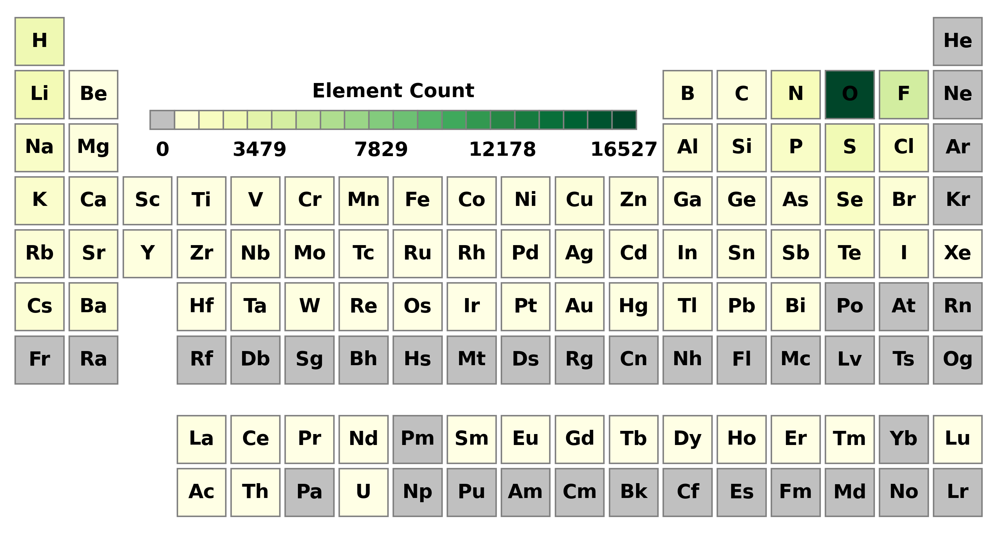

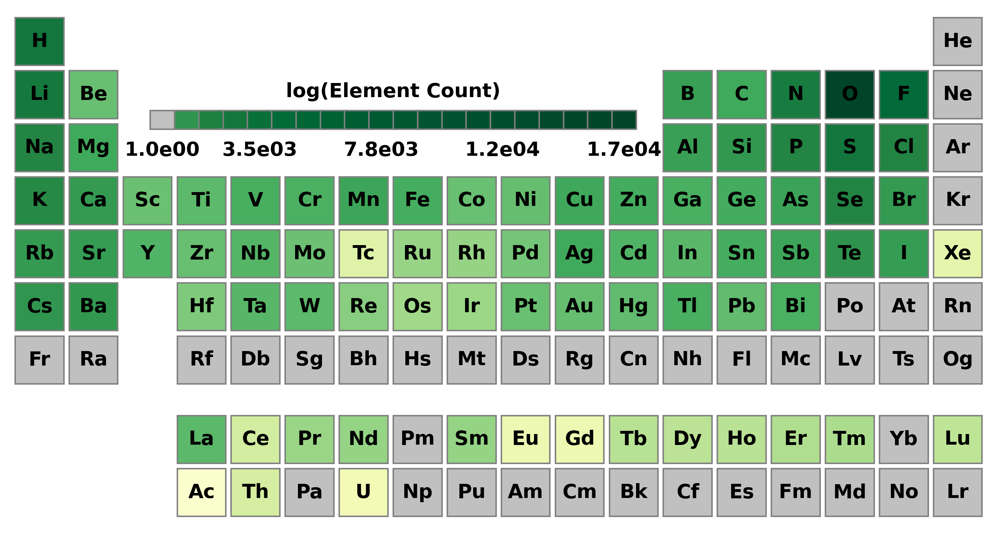

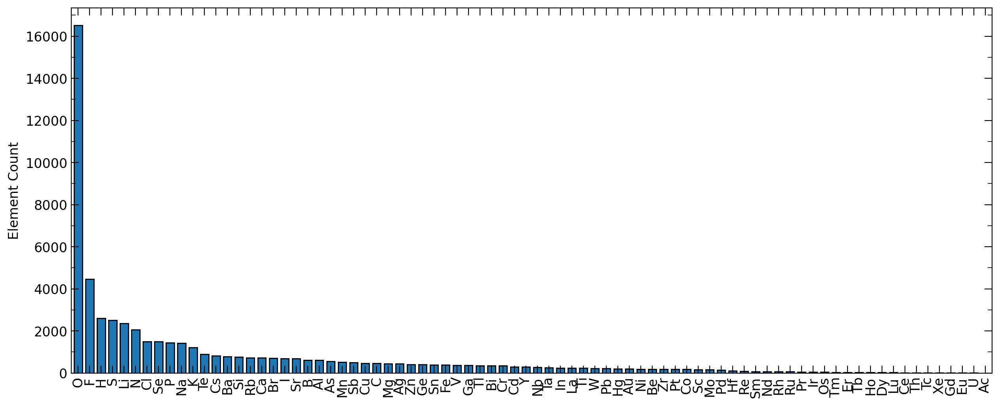

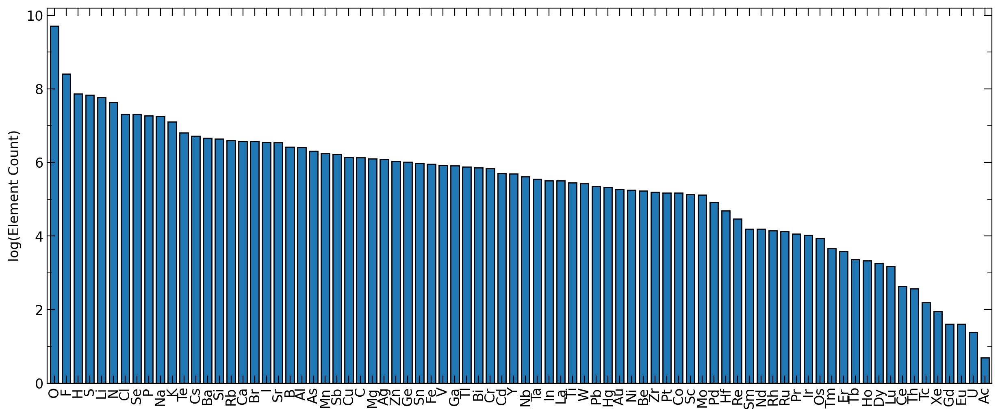

In [11]:
# Visualize element prevalence
formula = data_df.iloc[:, 1]

save_dir = './figures/element_prevalence'
element_prevalence(formula,
                   name='element_prevalence_ptable',
                   save_dir=save_dir,
                   log_scale=False)
element_prevalence(formula,
                   name='log_element_prevalence_ptable',
                   save_dir=save_dir,
                   log_scale=True)

plt.rcParams.update({'font.size': 12})
element_prevalence(formula,
                   name='element_prevalence',
                   save_dir=save_dir,
                   ptable_fig=False,
                   log_scale=False)
element_prevalence(formula,
                   name='log_element_prevalence',
                   save_dir=save_dir,
                   ptable_fig=False,
                   log_scale=True)

- From the above analysis, we can see that there are more oxides and fluorides in the data, 
while other cations are distributed more evenly.

## Enumerate the crystal systems as numbers:

1. Cubic
2. Tetragonal
3. Hexagonal
4. Orthorhombic
5. Monoclinic
6. Triclinic
7. Trigonal


In [12]:
crystal_system_dict = {
    'Cubic': 0,
    'Tetragonal': 1,
    'Hexagonal': 2,
    'Orthorhombic': 3,
    'Monoclinic': 4,
    'Triclinic': 5,
    'Trigonal': 6
}

In [13]:
# Replace the values in the 'crystal_system' column according to the dictionary replace_dict
data_df['crystal_system'] = data_df['crystal_system'].replace(crystal_system_dict)


In [14]:
data_df

,material_id,formula_pretty,composition,crystal_system,space_group,point_group,band_gap,volume,density,density_atomic,formation_energy_per_atom,e_total,e_ionic,e_electronic
0,mp-28967,Ba(PdS2)2,Ba2 Pd4 S8,4,11,2/m,0.7792,316.341404,5.022717,22.595815,-1.124079,17.048334,7.118969,9.929365
1,mp-766094,NbO2F,Nb4 O8 F4,3,19,222,2.8980,253.915299,3.764366,15.869706,-3.099174,17.572010,13.469477,4.102533
2,mp-36577,Sr(AsS2)2,Sr1 As2 S4,5,1,1,1.7212,196.220495,3.094976,28.031499,-0.766100,18.488667,12.443616,6.045051
3,mp-1102092,NaFe(SO4)2,Na4 Fe4 S8 O32,4,12,-1,2.0944,620.336826,2.901260,12.923684,-1.948264,9.596025,6.499905,3.096120
4,mp-720391,BH4NF4,B4 H16 N4 F16,3,62,mmm,7.4812,374.200384,1.860992,9.355010,-1.970766,6.216546,4.350314,1.866232
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7272,mp-759283,FeOF,Fe4 O4 F4,4,6,m,0.4687,140.001215,4.309906,11.666768,-2.077375,15.436682,10.943471,4.493211
7273,mp-752498,Li2VOF5,Li2 V1 O1 F5,3,44,mm2,3.2968,125.816773,2.320418,13.979641,-2.908932,14.103889,11.850884,2.253005
7274,mp-29983,Cs6Cl4O,Cs12 Cl8 O2,6,167,-3m,1.9928,861.371433,3.683011,39.153247,-1.904219,9.068753,6.383751,2.685002
7275,mp-568024,ICl,I8 Cl8,4,14,2/m,1.4968,579.503390,3.721820,36.218962,-0.483976,5.902496,2.110160,3.792336


In [15]:
# save the cleaned data
save_path = os.path.join(current_dir, './data/cleaned_data.csv')
data_df.to_csv(save_path, index=False)

## Check the e_electronic distribution

In [16]:
# use the plotly violin plot to show the distribution of the target
fig = px.violin(data_df, y='e_electronic', box=True, points='all', hover_data=data_df.columns)
fig.update_layout(
    title='Distribution of the target'
)

In [17]:
# statistical outliers
from scipy import stats
import seaborn as sns
column_name = 'e_electronic'
# Z-score
z_scores = stats.zscore(data_df[column_name])

# Find the index where Z-score is greater than 3 or less than -3
outlier_indices = (z_scores > 3) | (z_scores < -3)
outliers = data_df[column_name][outlier_indices]
print("Potential outliers:")
print(outliers)


Potential outliers:
260     46857.910510
3670     1928.229887
5112    25148.816525
6006     3851.815672
Name: e_electronic, dtype: float64


In [18]:
# remove the outliers
data_df_without_outliers = data_df[~outlier_indices]

In [19]:
# use the plotly violin plot to show the distribution of the target
fig = px.violin(data_df_without_outliers, y='e_electronic', box=True, points='all', hover_data=data_df.columns)
fig.update_layout(
    title='Distribution of the target'
)

In [20]:
# use the plotly box plot to show the distribution of the target
fig = px.box(data_df_without_outliers, y='e_electronic', points='all', hover_data=data_df.columns)
fig.show()

In [21]:
# drop the outliers which greater than 400
data_df_without_outliers = data_df_without_outliers[data_df_without_outliers['e_electronic'] < 400]

In [22]:
# use the plotly violin plot to show the distribution of the target
fig = px.violin(data_df_without_outliers, y='e_electronic', box=True, points='all', hover_data=data_df.columns)
fig.update_layout(
    title='Distribution of the target'
)

In [23]:
data_df_without_outliers.shape

(7263, 14)

## Check the ionic Distribution

In [27]:
# use the plotly violin plot to show the distribution of the target
fig = px.violin(data_df_without_outliers, y='e_ionic', box=True, points='all', hover_data=data_df_without_outliers.columns)
fig.update_layout(
    title='Distribution of the target'
)

In [28]:
column_name = 'e_ionic'
# Z-score
z_scores = stats.zscore(data_df_without_outliers[column_name])

# Find the index where Z-score is greater than 3 or less than -3
outlier_indices = (z_scores > 3) | (z_scores < -3)
outliers = data_df_without_outliers[column_name][outlier_indices]
print("Potential outliers:")
print(outliers)

Potential outliers:
5354    126567.273642
Name: e_ionic, dtype: float64


In [29]:
# remove the outliers
data_df_without_outliers = data_df_without_outliers[~outlier_indices]

In [30]:
# use the plotly violin plot to show the distribution of the target again
fig = px.violin(data_df_without_outliers, y='e_ionic', box=True, points='all', hover_data=data_df_without_outliers.columns)
fig.update_layout(
    title='Distribution of the target'
)

In [31]:
data_df_without_outliers.shape

(7262, 14)

- Than, we moved away 15 items from the raw data, and we have 7262 items left.

In [32]:
# save the cleaned data without outliers
save_path = os.path.join(current_dir, './data/cleaned_data_without_outliers.csv')
data_df_without_outliers.to_csv(save_path, index=False)

## Check the ralationship between the target and the features

In [25]:
# use plotly to plot the ralationship between the target and the features
# create a figure
fig = go.Figure()

for feature in data_df_without_outliers.columns[3:8]:
    fig.add_trace(go.Scatter(x=data_df_without_outliers[feature], 
                             y=data_df_without_outliers['e_electronic'], mode='markers', name=feature))


# update the layout of the figure
fig.update_layout(
    title='Relationship between the target and the features',
    xaxis_title='Features',
    yaxis_title='Target',
    xaxis_type='log',
    yaxis_type='log',
    legend=dict(x=0, y=1, traceorder='normal', font=dict(family='sans-serif', size=12, color='black'),
                bgcolor='rgba(255, 255, 255, 0.5)', bordercolor='black', borderwidth=1),
)
fig.show()

In [26]:
# divide to two figure
# create a figure
fig = go.Figure()

for feature in data_df_without_outliers.columns[8:]:
    fig.add_trace(go.Scatter(x=data_df_without_outliers[feature], 
                             y=data_df_without_outliers['e_electronic'], mode='markers', name=feature))


# update the layout of the figure
fig.update_layout(
    title='Relationship between the target and the features',
    xaxis_title='Features',
    yaxis_title='Target',
    xaxis_type='log',
    yaxis_type='log',
    legend=dict(x=0, y=1, traceorder='normal', font=dict(family='sans-serif', size=12, color='black'),
                bgcolor='rgba(255, 255, 255, 0.5)', bordercolor='black', borderwidth=1),
)
fig.show()

- We can see that the target 'e_electronic' has a high correlation with the features 'band_gap' and 'density'.